In [ ]:
!pip install visualkeras

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.7/993.7 kB 48.3 MB/s eta 0:00:00


In [ ]:
!pip install split-folders

# **Import Modul**

In [ ]:
import visualkeras
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import os
import matplotlib.image as mpimg
import warnings
import shutil
import matplotlib.image as mpimg
import splitfolders
import locale

from math import ceil
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc, accuracy_score
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Input, Dropout, Flatten, Conv2D
from tensorflow.keras.layers import BatchNormalization, Activation, MaxPooling2D, GroupNormalization
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, TensorBoard
from tensorflow.keras.metrics import Precision, Recall, AUC
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras import regularizers
from google.colab import files
from sklearn.preprocessing import LabelEncoder
from PIL import Image
from sklearn.metrics import (
    classification_report,
    confusion_matrix,
    roc_auc_score,
    roc_curve, auc
)
from keras.utils import to_categorical, plot_model
from sklearn.impute import SimpleImputer


warnings.filterwarnings('ignore')

# **Train Test Split**

In [ ]:
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [ ]:
if not os.path.exists("/content/data"):
  os.mkdir("/content/data")

In [ ]:
!unzip -q /content/train.zip -d "/content/data"

In [ ]:
dataset_path = "/content/data/train"

In [ ]:
splitfolders.ratio(dataset_path, output="/content/dataset", seed=1337, ratio=(.9, .1))

Copying files: 4954 files [00:00, 7931.13 files/s]


In [ ]:
train_dir = "/content/drive/MyDrive/Deep Learning/Data/train"
val_dir = "/content/drive/MyDrive/Deep Learning/Data/val"

In [ ]:
shutil.rmtree(train_dir)
shutil.rmtree(val_dir)

In [ ]:
shutil.rmtree("/content/dataset")

# **Distribusi Data**

In [ ]:
def load_images_from_folder(folder):
    images = []
    labels = []
    for filename in os.listdir(folder):
        path = os.path.join(folder, filename)
        if os.path.isdir(path):
            for img_filename in os.listdir(path):
                img_path = os.path.join(path, img_filename)
                try:
                    img = Image.open(img_path)
                    img = img.convert('RGB')
                    images.append(np.array(img))
                    labels.append(filename)
                except Exception as e:
                    print(f"Error loading image: {img_path}, {e}")
    return images, labels

images, labels = load_images_from_folder(dataset_path)

In [ ]:
def plot_label_distribution(labels, title):
  label_counts = pd.Series(labels).value_counts()
  plt.figure(figsize=(10, 5))
  sns.barplot(x=label_counts.index, y=label_counts.values)
  plt.title(title)
  plt.xlabel('Labels')
  plt.ylabel('Count')
  plt.show()

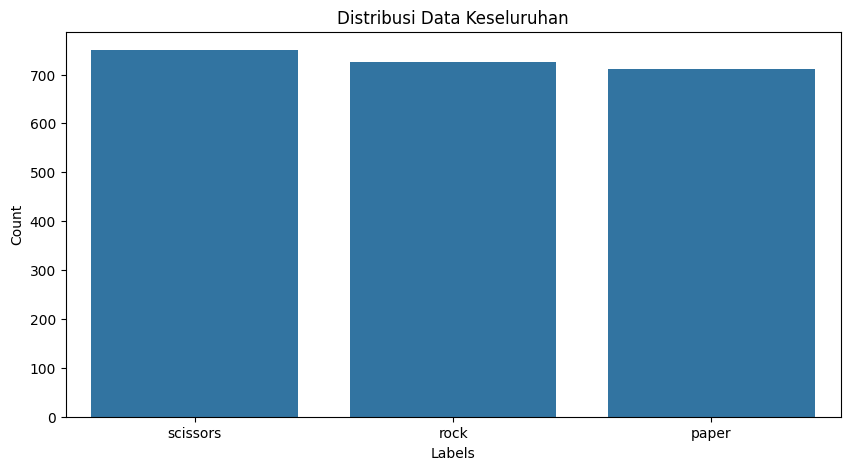

In [ ]:
plot_label_distribution(labels, 'Distribusi Data Keseluruhan')

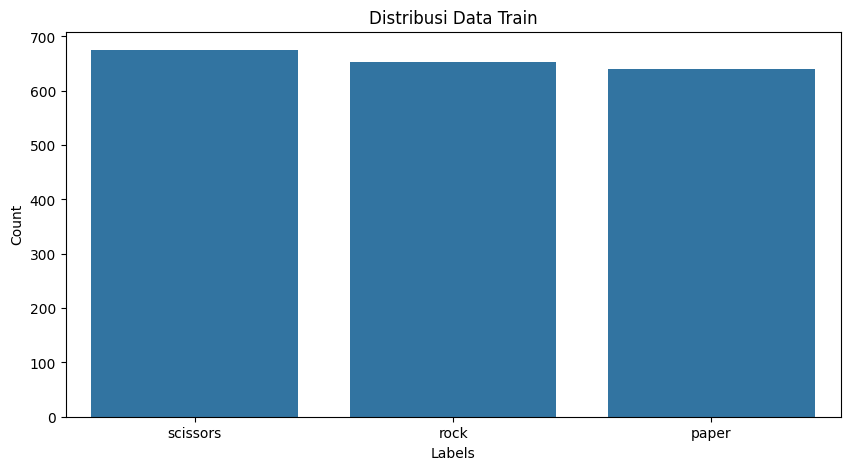

In [ ]:
images_train, labels_train = load_images_from_folder(train_dir)
plot_label_distribution(labels_train, 'Distribusi Data Train')

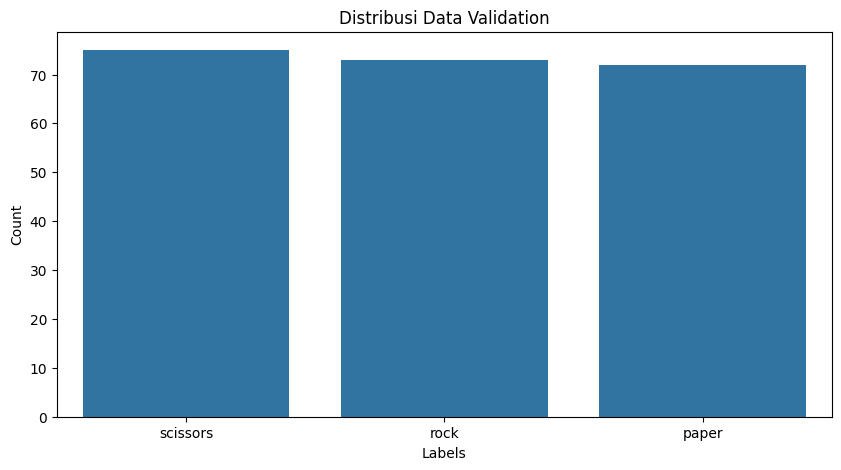

In [ ]:
images_val, labels_val = load_images_from_folder(val_dir)
plot_label_distribution(labels_val, 'Distribusi Data Validation')

# **Data Preprocessing**

In [ ]:
le = LabelEncoder()
labels_encoded = le.fit_transform(labels)

train_images, test_images, train_labels, test_labels = train_test_split(
    np.array(images), labels_encoded, test_size=0.2, random_state=42
)

In [ ]:
train_images_resized = tf.image.resize(train_images, (227, 227)).numpy().astype('float32') / 255
test_images_resized = tf.image.resize(test_images, (227, 227)).numpy().astype('float32') / 255

train_images_vgg = tf.image.resize(train_images, (224, 224)).numpy().astype('float32') / 255
test_images_vgg = tf.image.resize(test_images, (224, 224)).numpy().astype('float32') / 255

In [ ]:
train_labels_cat = to_categorical(train_labels, num_classes=3)
test_labels_cat = to_categorical(test_labels, num_classes=3)

In [ ]:
train_datagen = ImageDataGenerator(
     rescale=1./255,
                    rotation_range=20,
                    horizontal_flip=True,
                    vertical_flip=True,
                    shear_range=0.2,
                    fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
train_generator = train_datagen.flow_from_directory(
    "/content/dataset/train",
    target_size=(150,150),
    batch_size=32,
    class_mode= 'categorical'
)

Found 4453 images belonging to 13 classes.


In [ ]:

validation_generator = train_datagen.flow_from_directory(
    "/content/dataset/val",
    target_size=(150,150),
    batch_size=32,
    class_mode= 'categorical'
)

Found 501 images belonging to 13 classes.


In [ ]:
train_generator_alex = train_datagen.flow_from_directory(
        train_dir,
        target_size=(227,227),
        color_mode='rgb',
        batch_size=32,
        class_mode='categorical')

validation_generator_alex = validation_datagen.flow_from_directory(
        val_dir,
        target_size=(227,227),
        batch_size=32,
        color_mode='rgb',
        class_mode='categorical')

Found 1968 images belonging to 3 classes.
Found 220 images belonging to 3 classes.


In [ ]:
train_generator_vgg = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224,224),
        color_mode='rgb',
        batch_size=32,
        class_mode='categorical')

validation_generator_vgg = validation_datagen.flow_from_directory(
        val_dir,
        target_size=(224,224),
        batch_size=32,
        color_mode='rgb',
        class_mode='categorical')

Found 1968 images belonging to 3 classes.
Found 220 images belonging to 3 classes.


In [ ]:
train_generator_alex.class_indices

{'paper': 0, 'rock': 1, 'scissors': 2}

# **Model**

# **CNN**

In [ ]:
model = tf.keras.models.Sequential([
  tf.keras.layers.Conv2D(32, (3,3), activation = 'relu', input_shape= (150,150,3)),
  tf.keras.layers.MaxPooling2D(2,2),
  tf.keras.layers.Conv2D(64,(3,3), activation= 'relu'),
  tf.keras.layers.MaxPooling2D(2,2),
  tf.keras.layers.Conv2D(128,(3,3), activation= 'relu'),
  tf.keras.layers.MaxPooling2D(2,2),
  tf.keras.layers.Conv2D(256,(3,3), activation= 'relu'),
  tf.keras.layers.MaxPooling2D(2,2),
  tf.keras.layers.Conv2D(512,(3,3), activation= 'relu'),
  tf.keras.layers.MaxPooling2D(2,2),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dense(512, activation= 'relu'),
  tf.keras.layers.Dense(13, activation= 'softmax')
])

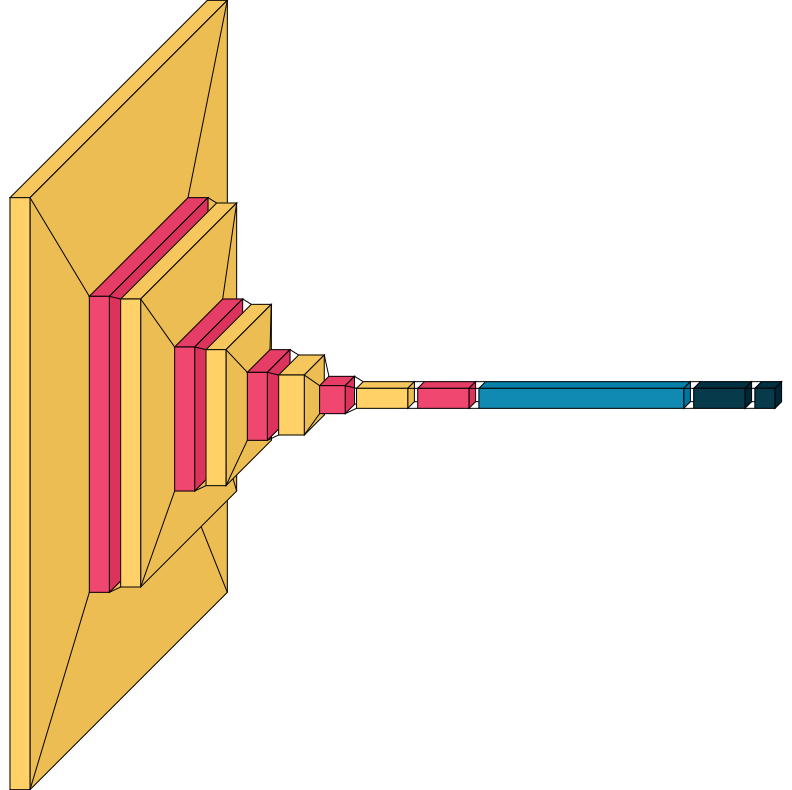

In [ ]:
visualkeras.layered_view(model)

In [ ]:
import tensorflow as tf
model.compile(loss = 'categorical_crossentropy',
              optimizer = tf.keras.optimizers.Adadelta(learning_rate=0.1),
              metrics=['accuracy'])

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=25,
    epochs=100,
    validation_data=validation_generator,
    validation_steps=5,
    verbose=2)

Epoch 1/100
25/25 - 7s - 268ms/step - accuracy: 0.6150 - loss: 1.0735 - val_accuracy: 0.7063 - val_loss: 0.8757
Epoch 2/100
25/25 - 4s - 175ms/step - accuracy: 0.6106 - loss: 1.0746 - val_accuracy: 0.6187 - val_loss: 1.0072
Epoch 3/100
25/25 - 4s - 158ms/step - accuracy: 0.6388 - loss: 1.0539 - val_accuracy: 0.6125 - val_loss: 1.1449
Epoch 4/100
25/25 - 4s - 162ms/step - accuracy: 0.6375 - loss: 1.0132 - val_accuracy: 0.5714 - val_loss: 0.9544
Epoch 5/100
25/25 - 5s - 203ms/step - accuracy: 0.6662 - loss: 1.0224 - val_accuracy: 0.6875 - val_loss: 1.0047
Epoch 6/100
25/25 - 1s - 52ms/step - accuracy: 0.6458 - loss: 0.9968 - val_accuracy: 0.5938 - val_loss: 1.0985
Epoch 7/100
25/25 - 6s - 221ms/step - accuracy: 0.6575 - loss: 0.9947 - val_accuracy: 0.6812 - val_loss: 0.8444
Epoch 8/100
25/25 - 4s - 159ms/step - accuracy: 0.6625 - loss: 0.9770 - val_accuracy: 0.4286 - val_loss: 1.5923
Epoch 9/100
25/25 - 5s - 203ms/step - accuracy: 0.6913 - loss: 0.8721 - val_accuracy: 0.6562 - val_loss: 

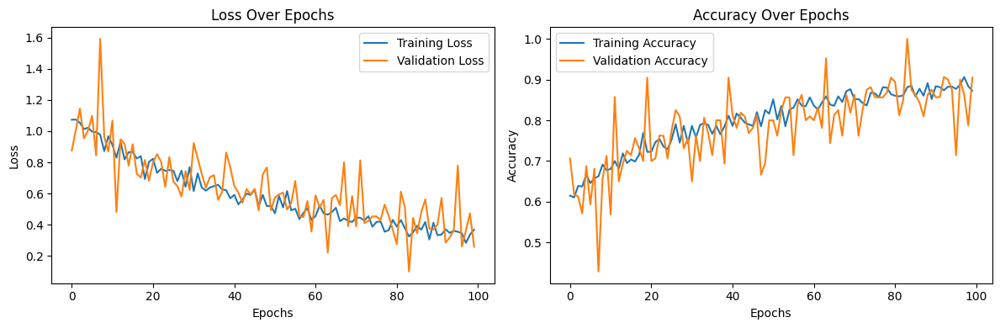

In [ ]:
import matplotlib.pyplot as plt

# Asumsikan 'history' adalah hasil dari model.fit() yang Anda dapatkan
# Visualisasi Loss
plt.figure(figsize=(12, 4))

# Plot loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot accuracy
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Asumsikan 'history' adalah hasil dari model.fit() yang Anda dapatkan
# Visualisasi Loss
plt.figure(figsize=(12, 4))

# Plot loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot accuracy
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()

# Simpan plot ke file
plt.savefig('training_validation_plot.png', dpi=300)  # Menyimpan sebagai PNG dengan resolusi 300 dpi
plt.close()  # Menutup figure setelah disimpan


### **Alexnet**

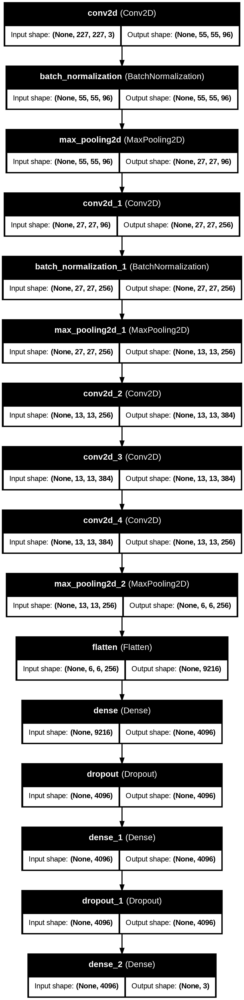

In [ ]:
alex_model = Sequential([
    Conv2D(96, (11, 11), strides=4, activation='relu', input_shape=(227, 227, 3)),
    BatchNormalization(),
    MaxPooling2D((3, 3), strides=2),
    Conv2D(256, (5, 5), padding='same', activation='relu'),
    BatchNormalization(),
    MaxPooling2D((3, 3), strides=2),
    Conv2D(384, (3, 3), padding='same', activation='relu'),
    Conv2D(384, (3, 3), padding='same', activation='relu'),
    Conv2D(256, (3, 3), padding='same', activation='relu'),
    MaxPooling2D((3, 3), strides=2),
    Flatten(),
    Dense(4096, activation='relu',),
    Dropout(0.5),
    Dense(4096, activation='relu', ),
    Dropout(0.5),
    Dense(3, activation='softmax')
])

plot_model(alex_model, show_shapes=True, show_layer_names=True)

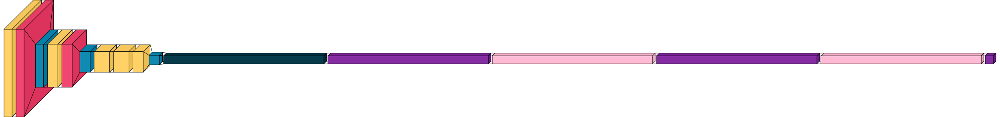

In [ ]:
visualkeras.layered_view(alex_model)

### **VGG16**

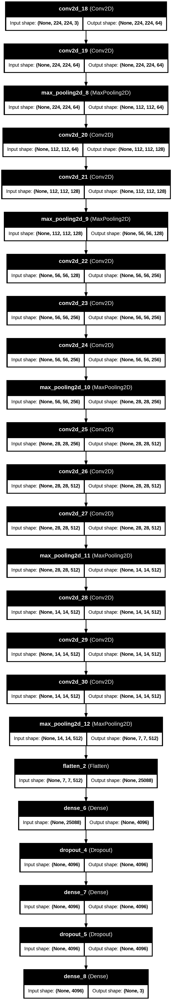

In [ ]:
vgg16_model = Sequential([
    Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=(224, 224, 3)),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2), strides=(2, 2)),

    Conv2D(128, (3, 3), activation='relu', padding='same'),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2), strides=(2, 2)),

    Conv2D(256, (3, 3), activation='relu', padding='same'),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2), strides=(2, 2)),

    Conv2D(512, (3, 3), activation='relu', padding='same'),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2), strides=(2, 2)),

    Conv2D(512, (3, 3), activation='relu', padding='same'),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2), strides=(2, 2)),

    Flatten(),
    Dense(4096, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    Dropout(0.5),
    Dense(4096, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    Dropout(0.5),
    Dense(3, activation='softmax')
])

plot_model(vgg16_model, show_shapes=True, show_layer_names=True)

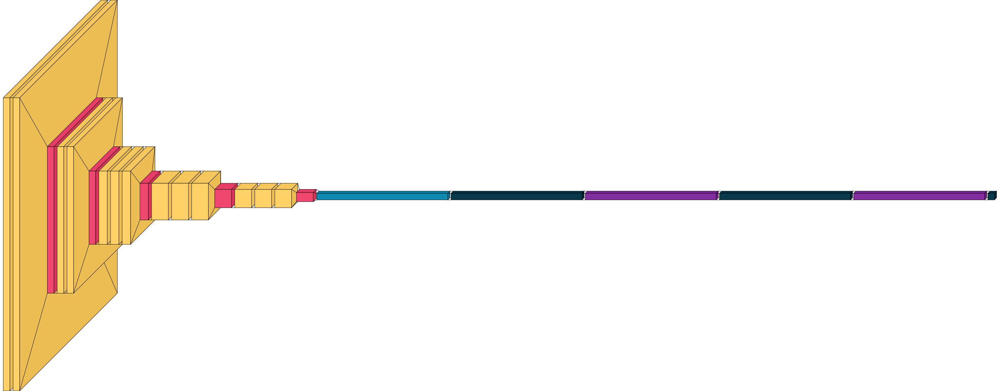

In [ ]:
visualkeras.layered_view(vgg16_model)

# **Training Model**

In [ ]:
log_dir_alex = "/content/logs/alex"
tensorboard_callback_alex = TensorBoard(log_dir=log_dir_alex, histogram_freq=1)

log_dir_vgg = "/content/logs/vgg"
tensorboard_callback_vgg = TensorBoard(log_dir=log_dir_vgg, histogram_freq=1)

# **Callbacks**

In [ ]:
class MyCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}, loss=0.01):
    if (logs.get('accuracy') > 0.95 and
            logs.get('val_accuracy') > 0.95):

       print('\n Val Akurasi telah mencapai target')
       self.model.stop_training = True

early_stopping = MyCallback()

In [ ]:
reduce_lr = ReduceLROnPlateau(
    monitor='val_accuracy',
    factor=0.2,
    patience=5,
    min_lr=1e-6
)

# **Metrics**

In [ ]:
metrics = ['accuracy', Precision(), Recall(), AUC(name="auc")]

### **Alexnet**

In [ ]:
alex_model.compile(loss="categorical_crossentropy",
                 optimizer=Adam(learning_rate=0.001),
                 metrics=metrics)

In [ ]:
history_alex = alex_model.fit(train_images_resized, train_labels_cat,
                    validation_split=0.2,
                    epochs=30,
                    batch_size=32,
                    callbacks=[reduce_lr, early_stopping, tensorboard_callback_alex])


Epoch 1/30
44/44 ━━━━━━━━━━━━━━━━━━━━ 32s 465ms/step - accuracy: 0.3665 - auc: 0.5376 - loss: 10.4583 - precision: 0.4018 - recall: 0.1248 - val_accuracy: 0.2914 - val_auc: 0.4588 - val_loss: 1.1510 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0010
Epoch 2/30
44/44 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - accuracy: 0.5309 - auc: 0.7068 - loss: 0.9673 - precision: 0.5925 - recall: 0.2550 - val_accuracy: 0.3343 - val_auc: 0.5227 - val_loss: 1.2111 - val_precision: 0.3626 - val_recall: 0.2829 - learning_rate: 0.0010
Epoch 3/30
44/44 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - accuracy: 0.6419 - auc: 0.8147 - loss: 0.8109 - precision: 0.6907 - recall: 0.5481 - val_accuracy: 0.3600 - val_auc: 0.5828 - val_loss: 1.1710 - val_precision: 0.3984 - val_recall: 0.2914 - learning_rate: 0.0010
Epoch 4/30
44/44 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - accuracy: 0.6115 - auc: 0.8184 - loss: 0.7994 - precision: 0.6692 - recall: 0.5203 - val_accuracy: 0.6029 - val_auc: 0.8059 - val_loss: 0.830

In [ ]:
history_alex_2 = alex_model.fit(
    train_generator_alex,
    epochs = 30,
    validation_data = validation_generator_alex,
    validation_steps = 5,
    callbacks=[early_stopping, reduce_lr, tensorboard_callback_alex]
)

Epoch 1/20
121/123 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - accuracy: 0.3249 - auc: 0.5007 - loss: 4.5252 - precision_2: 0.2735 - recall_2: 0.0435

KeyboardInterrupt: 

### **VGG16**

In [ ]:
vgg16_model.compile(loss="categorical_crossentropy",
                 optimizer=SGD(learning_rate=0.01, momentum=0.9, ),
                 metrics=metrics)

In [ ]:
history_vgg16 = vgg16_model.fit(
    train_generator_vgg,
    validation_data = validation_generator_vgg,
    epochs=50,
    batch_size=32,
    callbacks=[early_stopping, reduce_lr, tensorboard_callback_vgg]
)

Epoch 1/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 26s 307ms/step - accuracy: 0.3485 - auc: 0.5000 - loss: nan - precision: 0.0000e+00 - recall: 0.0000e+00 - val_accuracy: 0.3409 - val_auc: 0.5000 - val_loss: nan - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0100
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 16s 234ms/step - accuracy: 0.3422 - auc: 0.5000 - loss: nan - precision: 0.0000e+00 - recall: 0.0000e+00 - val_accuracy: 0.3409 - val_auc: 0.5000 - val_loss: nan - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0100
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 15s 221ms/step - accuracy: 0.3388 - auc: 0.5000 - loss: nan - precision: 0.0000e+00 - recall: 0.0000e+00 - val_accuracy: 0.3409 - val_auc: 0.5000 - val_loss: nan - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0100
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 16s 240ms/step - accuracy: 0.3503 - auc: 0.5000 - loss: nan - precision: 0.0000e+00 - recall: 0.0000e+00 - val_accuracy: 0.3409 - v

# **Evaluation**

### **Alexnet**

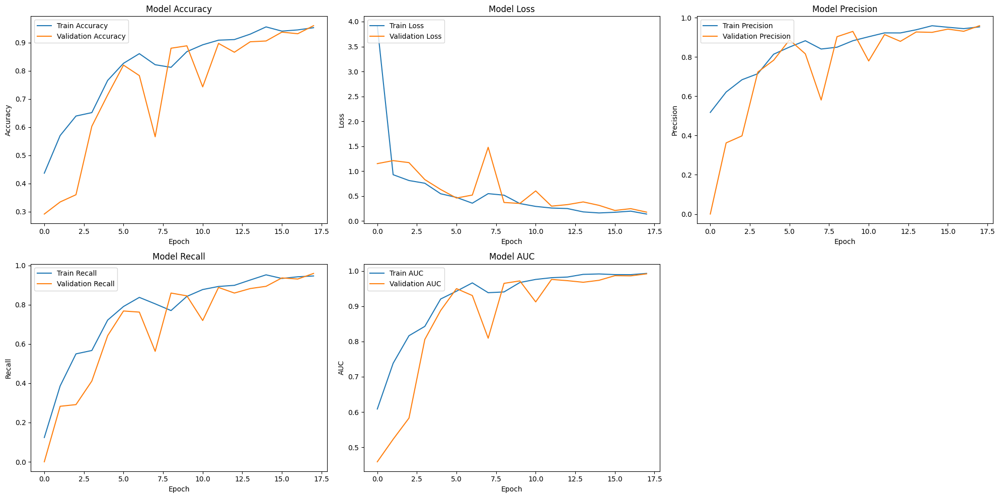

In [ ]:
def plot_training_history(history):
    plt.figure(figsize=(20, 10))

    plt.subplot(2, 3, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(2, 3, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(2, 3, 3)
    plt.plot(history.history['precision'], label='Train Precision')
    plt.plot(history.history['val_precision'], label='Validation Precision')
    plt.title('Model Precision')
    plt.ylabel('Precision')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(2, 3, 4)
    plt.plot(history.history['recall'], label='Train Recall')
    plt.plot(history.history['val_recall'], label='Validation Recall')
    plt.title('Model Recall')
    plt.ylabel('Recall')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(2, 3, 5)
    plt.plot(history.history['auc'], label='Train AUC')
    plt.plot(history.history['val_auc'], label='Validation AUC')
    plt.title('Model AUC')
    plt.ylabel('AUC')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.tight_layout()
    plt.show()

plot_training_history(history_alex)

In [ ]:
predictions = alex_model.predict(test_images_resized)
predicted_classes = np.argmax(predictions, axis=1)

conf_matrix = confusion_matrix(test_labels, predicted_classes)

class_report = classification_report(test_labels, predicted_classes)
print("\nClassification Report:\n", class_report)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.92      0.94       131
           1       0.92      0.99      0.95       154
           2       1.00      0.97      0.99       153

    accuracy                           0.96       438
   macro avg       0.96      0.96      0.96       438
weighted avg       0.96      0.96      0.96       438



In [ ]:
results = alex_model.evaluate(test_images_resized, test_labels_cat)

test_loss = results[0]
test_acc = results[1]

miss_class_rate = 1 - test_acc
print(f'Misclassification Rate: {miss_class_rate:.4f}')

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.9615 - auc: 0.9928 - loss: 0.1469 - precision: 0.9700 - recall: 0.9615
Misclassification Rate: 0.0388


ROC AUC Score: 0.9957


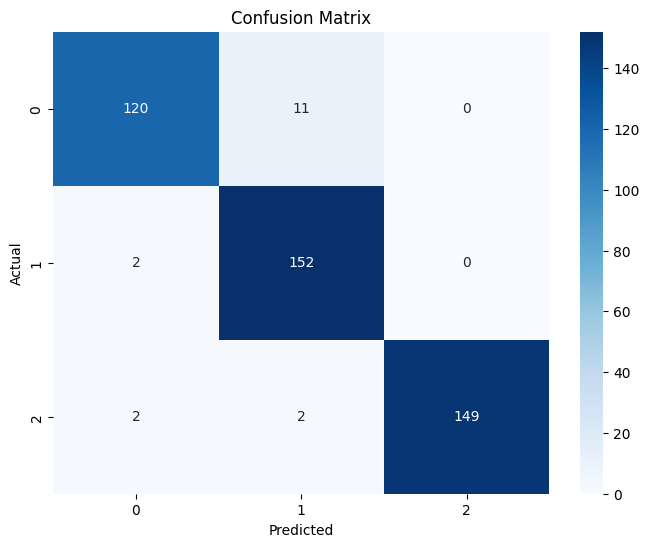

In [ ]:
auc_roc = roc_auc_score(test_labels_cat, predictions, multi_class="ovr")
print(f'ROC AUC Score: {auc_roc:.4f}')

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues")
plt.title("Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

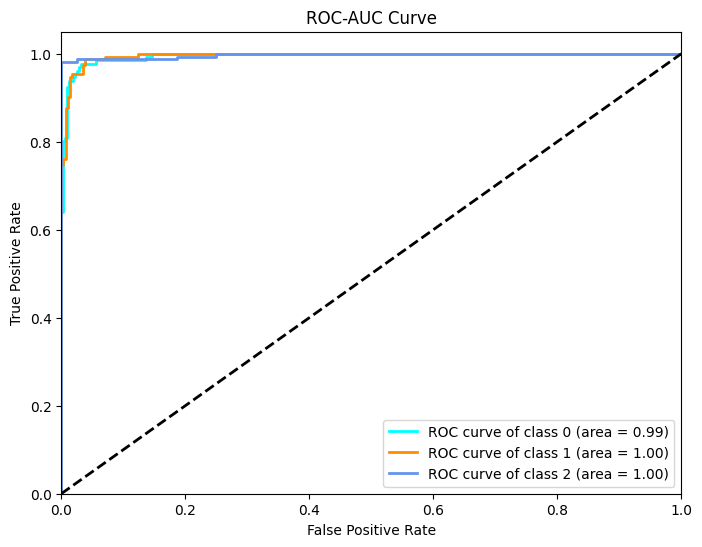

In [ ]:
fpr = {}
tpr = {}
roc_auc = {}

for i in range(3):
    fpr[i], tpr[i], _ = roc_curve(test_labels_cat[:, i], predictions[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

plt.figure(figsize=(8, 6))
colors = ['aqua', 'darkorange', 'cornflowerblue']
for i in range(3):
    plt.plot(fpr[i], tpr[i], color=colors[i], lw=2, label=f'ROC curve of class {i} (area = {roc_auc[i]:0.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC-AUC Curve')
plt.legend(loc="lower right")
plt.show()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/alex

<IPython.core.display.Javascript object>

### **VGG16**

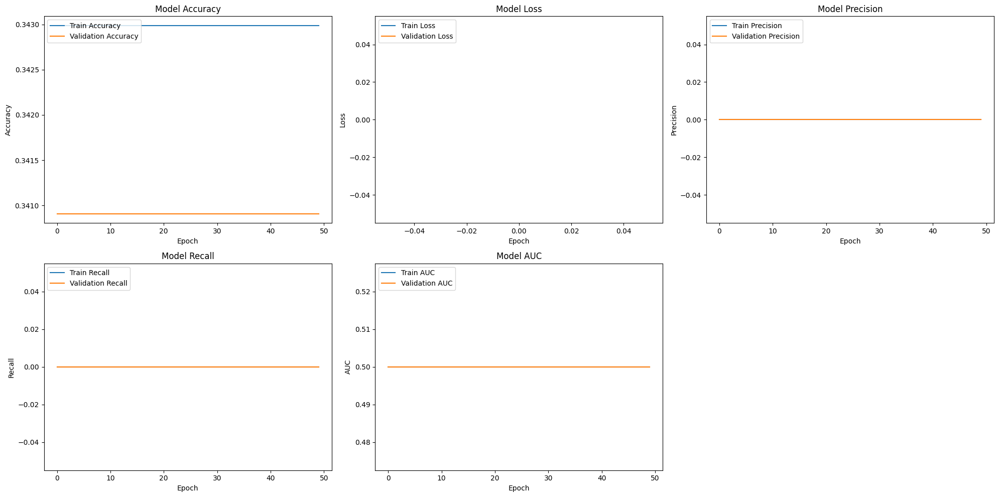

In [ ]:
plot_training_history(history_vgg16)

In [ ]:
predictions_vgg = vgg16_model.predict(validation_generator_vgg)
predicted_classes_vgg = np.argmax(predictions_vgg, axis=1)

true_classes_vgg = validation_generator_vgg.classes
conf_matrix_vgg = confusion_matrix(true_classes_vgg, predicted_classes_vgg)

class_report_vgg = classification_report(true_classes_vgg , predicted_classes_vgg)
print("\nClassification Report:\n", class_report_vgg)

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 151ms/step

Classification Report:
               precision    recall  f1-score   support

           0       0.33      1.00      0.49        72
           1       0.00      0.00      0.00        73
           2       0.00      0.00      0.00        75

    accuracy                           0.33       220
   macro avg       0.11      0.33      0.16       220
weighted avg       0.11      0.33      0.16       220



In [ ]:
results_vgg = vgg16_model.evaluate(validation_generator_vgg)

test_loss = results_vgg[0]
test_acc = results_vgg[1]

miss_class_rate = 1 - test_acc
print(f'Misclassification Rate: {miss_class_rate:.4f}')

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 132ms/step - accuracy: 0.3495 - auc: 0.5000 - loss: nan - precision: 0.0000e+00 - recall: 0.0000e+00
Misclassification Rate: 0.6591


In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/vgg

<IPython.core.display.Javascript object>

# **KESIMPULAN**
# Berdasarkan hasil evaluasi deari kedua model, maka dapat disimpulkan bahwa model Alexnet memiliki performa yang baik jika dilatih dengan data Rock-Paper-Scissors yang merupakan data latih relatih kecil. VGG16 mengalami overfitt karena secara arsitektur, model memiliki ukuran yang sangat besar dan kurang cocok untuk data yang relatif memiliki jumlah data yang kecil